In [303]:
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os


In [304]:
targetPart = "vision_windscreen_rear"

In [305]:
labelDfCsv = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/windscreen_rear_Rear View_img_labels.csv"
labelDf = pd.read_csv(labelDfCsv)


In [306]:
partAum = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels/aum_values.csv"
partAumDf = pd.read_csv(partAum)
partAumDf.sort_values(by="aum", ascending=True, inplace=True)

In [307]:
partAumDf["CaseID"] = partAumDf.apply(lambda x : int(x["sample_id"].split("_")[0]), axis=1)

In [308]:
partAumDf = partAumDf.merge(labelDf, on="CaseID")

In [309]:
partAumDf

,sample_id,aum,CaseID,Unnamed: 0,vision_windscreen_rear,view,filename,url
0,11084800_492719675.JPG,-3.382682,11084800,10028,1,Rear View,11084800_492719675.JPG,http://192.168.1.4:8888/buckets/raw_imgs/11084...
1,12174831_548602325.JPG,-2.797461,12174831,3580,0,Rear View,12174831_548602325.JPG,http://192.168.1.4:8888/buckets/raw_imgs/12174...
2,11971797_537515831.JPG,-2.748503,11971797,4191,0,Rear View,11971797_537515831.JPG,http://192.168.1.4:8888/buckets/raw_imgs/11971...
3,13007727_592340103.JPG,-2.704395,13007727,456,0,Rear View,13007727_592340103.JPG,http://192.168.1.4:8888/buckets/raw_imgs/13007...
4,10365658_456037332.JPG,-2.654150,10365658,3427,1,Rear View,10365658_456037332.JPG,http://192.168.1.4:8888/buckets/raw_imgs/10365...
...,...,...,...,...,...,...,...,...
7402,12248538_552101878.JPG,8.088411,12248538,4730,0,Rear View,12248538_552101878.JPG,http://192.168.1.4:8888/buckets/raw_imgs/12248...
7403,12359204_558860507.JPG,8.107031,12359204,2873,1,Rear View,12359204_558860507.JPG,http://192.168.1.4:8888/buckets/raw_imgs/12359...
7404,10079201_441297118.JPG,8.229427,10079201,7950,1,Rear View,10079201_441297118.JPG,http://192.168.1.4:8888/buckets/raw_imgs/10079...
7405,11626894_520767184.JPG,9.129492,11626894,6979,1,Rear View,11626894_520767184.JPG,http://192.168.1.4:8888/buckets/raw_imgs/11626...


In [310]:


def display_label_img(filename, label, aum, ood=0):
    plt.title(f"Gt : {label} AUM :{aum} ood : {ood}")
    srcImgsDir = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/imgs"
    path = os.path.join( srcImgsDir, filename)
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.axis('off')
    plt.imshow(img)

In [311]:

def view_samples(samples):
    fig = plt.figure(figsize=(60, 80))
    maxRows = len(samples)

    for i,info in enumerate(samples, start=1):
        fig.add_subplot(
                maxRows,
                1,
                i,
            )
        display_label_img(info["filename"], info["gt_label"], info["aum"], info["ood_score"])

In [312]:
worstSampleToView = []
topN = 20
for i in range(topN):
    row = partAumDf.iloc[i]
    worstSampleToView.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })


In [313]:
bestSampleToView = []
for i in range(topN):
    row = partAumDf.iloc[-(i + 1)]
    bestSampleToView.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })


In [314]:
hardestSampleToView = []
medianAUM = partAumDf["aum"].median()

leftHalfDf = partAumDf[partAumDf["aum"] < medianAUM].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= medianAUM].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    hardestSampleToView.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [315]:
hardQuarterSamples = []
q1AUM = partAumDf["aum"].quantile(0.25)

leftHalfDf = partAumDf[partAumDf["aum"] < q1AUM].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= q1AUM].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    hardQuarterSamples.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [316]:
easyQuarterSamples = []
q1AUM = partAumDf["aum"].quantile(0.75)

leftHalfDf = partAumDf[partAumDf["aum"] < q1AUM].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= q1AUM].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    easyQuarterSamples.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [317]:
aroundZeroDf = []
aroundZeroAum = 0.0

leftHalfDf = partAumDf[partAumDf["aum"] < aroundZeroAum].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= aroundZeroAum].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    aroundZeroDf.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [318]:
import plotly.express as px

fig = px.histogram(partAumDf, x="aum")
medianAum = partAumDf["aum"].median()
q1Aum = partAumDf["aum"].quantile(0.25)
q3Aum = partAumDf["aum"].quantile(0.75)
q30Aum = partAumDf["aum"].quantile(0.3)
q30Aum = partAumDf["aum"].quantile(0.3)

fig.add_vline(x=q1Aum, line_width=2, line_color="red")
fig.add_vline(x=medianAum, line_width=2, line_color="purple")
fig.add_vline(x=q3Aum, line_width=2, line_color="green")
fig.add_vline(x=q30Aum, line_width=2, line_color="green")

fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = [-0.5, 0,q1Aum, medianAum, q3Aum,q30Aum, 6, 8],
    )
)

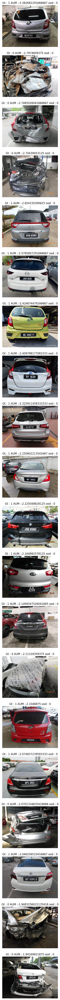

In [319]:
view_samples(worstSampleToView)

In [320]:
selectedCsv = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels/selected.csv"

In [321]:
selectedDf = pd.read_csv(selectedCsv)

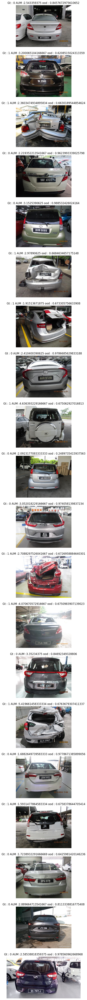

In [322]:
afterSelections = []
randomSamples= selectedDf.sample(20)
for _, row in randomSamples.iterrows():
    afterSelections.append({
        "filename" : row["sample_id"],
        "gt_label" : row["gt"],
        "aum" : row["aum"],
        "ood_score" : row["ood_score"],

    })
view_samples(afterSelections)

In [323]:
oriDf = pd.read_csv("/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels/all_info_before_select.csv")
oriDf

,Unnamed: 0.1,Unnamed: 0,pred,gt,probs_0,probs_1,filename,dataset_index,ood_score,sample_id,aum
0,0,0,0,0,0.991780,0.008220,10158407_445263873.JPG,0,0.934632,10158407_445263873.JPG,3.819702
1,1,1,1,1,0.004830,0.995170,12044906_541769236.JPG,0,0.658489,12044906_541769236.JPG,0.205086
2,2,2,1,1,0.000086,0.999913,10465497_460953433.JPG,0,0.676055,10465497_460953433.JPG,4.205013
3,3,3,1,1,0.004118,0.995882,10073402_441466358.JPG,0,0.661094,10073402_441466358.JPG,0.641256
4,4,4,1,1,0.007389,0.992611,11732606_525452674.JPG,0,0.649215,11732606_525452674.JPG,2.926839
...,...,...,...,...,...,...,...,...,...,...,...
10254,10254,95,1,1,0.042523,0.957477,10748619_474798760.JPG,2,0.534017,NaN,NaN
10255,10255,96,0,1,0.998743,0.001257,11915552_534583704.JPG,2,0.986793,NaN,NaN
10256,10256,97,1,1,0.464643,0.535357,11962805_537683029.JPG,2,0.000041,NaN,NaN
10257,10257,98,1,1,0.007205,0.992795,11357141_506405248.JPG,2,0.649877,NaN,NaN


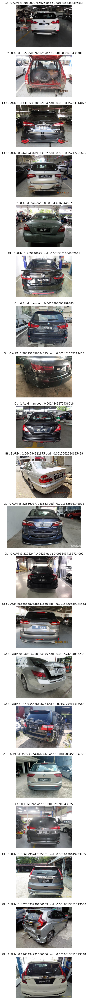

In [324]:
mostOodSamples = []
oodDf= oriDf.sort_values(by="ood_score", ascending=True).iloc[100:].head(20)
for _, row in oodDf.iterrows():
    mostOodSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["aum"],
        "ood_score" : row["ood_score"],

    })
view_samples(mostOodSamples)

In [325]:
cleanTrainDf = pd.read_csv("/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels_clean/pred_cleaned_windscreen_rear_Rear View_img_labels.csv")
cleanTrainDf= cleanTrainDf[cleanTrainDf["dataset_index"] == 2]

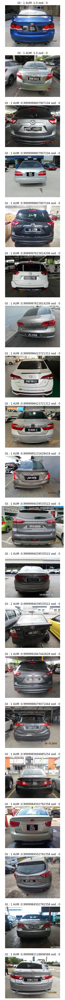

In [326]:
afterSelectionFNSamples = []
FNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0)].sort_values(by="probs_0", ascending=False).head(20)
for _, row in FNSamples.iterrows():
    afterSelectionFNSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_0"],
        "ood_score" : row["pred"],

    })
view_samples(afterSelectionFNSamples)

In [347]:
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1) & (cleanTrainDf["dataset_index"] == 2)]
fpr = len(FPSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 0) & (cleanTrainDf["dataset_index"] == 2)])
fpr

0.086

In [348]:
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1) & (cleanTrainDf["dataset_index"] == 2) 
& (cleanTrainDf["probs_1"] >= 0.7)]
true_fpr = len(FPSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 0) & (cleanTrainDf["dataset_index"] == 2)])
true_fpr

0.072

In [349]:
FNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["dataset_index"] == 2)]
fnr = len(FNSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 1) & (cleanTrainDf["dataset_index"] == 2)])
fnr

0.398

In [350]:
FNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["dataset_index"] == 2) 
& (cleanTrainDf["probs_0"] >= 0.7)]
true_fnr = len(FNSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 1) & (cleanTrainDf["dataset_index"] == 2)])
true_fnr

0.384

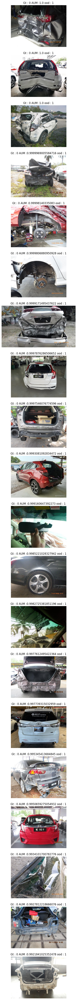

In [351]:

afterSelectionFPSamples = []
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1)].sort_values(by="probs_1", ascending=False).head(20)
for _, row in FPSamples.iterrows():
    afterSelectionFPSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_1"],
        "ood_score" : row["pred"],

    })
view_samples(afterSelectionFPSamples)

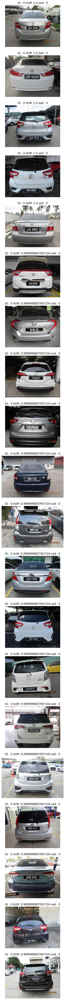

In [352]:
afterSelectionTNSamples = []
TNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 0)].sort_values(by="probs_0", ascending=False).head(20)
for _, row in TNSamples.iterrows():
    afterSelectionTNSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_0"],
        "ood_score" : row["pred"],

    })
view_samples(afterSelectionTNSamples)

In [353]:
afterSelectionTPSamples = []
TPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 1)].sort_values(by="probs_1", ascending=False).head(20)
for _, row in TPSamples.iterrows():
    afterSelectionTPSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_1"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionTPSamples)

In [354]:

afterSelectionFPSamples = []
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1) & (cleanTrainDf["probs_1"] >= 0.7)].sort_values(by="probs_1", ascending=True).head(20)
for _, row in FPSamples.iterrows():
    afterSelectionFPSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_1"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionFPSamples)

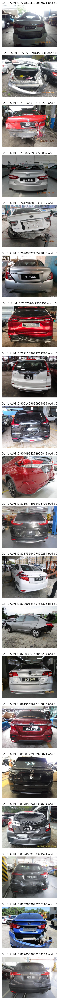

In [355]:
afterSelectionFNSamples = []
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for _, row in FPSamples.iterrows():
    afterSelectionFNSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_0"],
        "ood_score" : row["pred"],

    })
view_samples(afterSelectionFNSamples)